# Obtencion de propiedades de [atbuenosaires.com](https://www.atbuenosaires.com/Alq-Temporario)

*nota: La pagina tiene bastante codigo de JQuery y ajax*

Lo primero que hice fue explorar la manera en la que carga las propiedades cuando realiza una busqueda.

En la pagina principal tienen un buscador en el que se puede seleccionar el tipo de operacion(venta, alquiler, alq temporario), el tipo de propiedad (depto, casa ...), y la locacion/ubicacion.

Este ultimo parametro tiene algo particular porque solo encuentra cosas cuando se selecciona algo de las sugerencias, pero no rompe cuando se pone un texto cualquiera.

La busqueda llama la funcion `do_search()`  la cual construye un link de manera dinamica concatenando texto de los parametros del form. 
Esto es bastante feo.

Por otro lado cuando se va a la pestania de alquiler temporario la pagina va cargando de a poco las propiedades a medida que se scrollea hacia abajo.
Esto mediante un llamado de la funcion `get_next_page` la cual pide un query de ajax incrementando el numero de pagina y recibe una lista de objetos `<il>`
con la informacion de la propiedad. 
Esto resultados los agrega al nodo de  `id=propiedades` y cuando el numero de pagina es muy grande el query devuelve una pagina con  `<body>--NoMoreProperties-- </body>` 

Un nodo de la lista tiene la siguiente estructura
```html
<li>
    <a href="/p/378717-Departamento-en-Alquiler-temporario-en-San-Telmo-Perú-al-1300">
        <div class="prop-img">

            <div class="detalleColor resultadosB-favoritaSi animated bounceIn star-378717"><i class="fa fa-star"></i>
            </div>
            <div class="resultadosB-favoritaNo animated fadeInUp"><i class="fa fa-star-o"></i></div>
            <div class="prop-data">
                <div>35 m²</div><img
                    src="https://static.tokkobroker.com/tfw/img/prop-icons/suptotalconst.png?20190705061504">
            </div>
            <div class="prop-data2">
                <div>1</div><img src="https://static.tokkobroker.com/tfw/img/prop-icons/ambientes.png?20190705061504">
            </div>
            <div class="prop-img-bg animated fadeIn ">
                <div class="ver-ficha-box animated fadeInUp">VER DETALLES</div>
            </div><img class="dest-img"
                src="https://static.tokkobroker.com/water_pics/41766741736377234998772001103543741532070269742642577056108297622404199955171.jpg"
                alt="Foto Departamento en Alquiler temporario en  San Telmo ,  Capital Federal  Perú al 1300"
                title="Foto Departamento en Alquiler temporario en  San Telmo ,  Capital Federal  Perú al 1300">
        </div>

        <div class="prop-desc">
            <div class="prop-desc-tipo-ub">Departamento en Alquiler temporario en San Telmo , Capital Federal </div>
            <div class="prop-desc-dir">Perú al 1300</div>
        </div>
    </a>
    <div class="prop-valor-nro" style="cursor:pointer" onclick="star_unstar_prop(378717)">$19.500<div
            class="codref detalleColorText">AOT1410 AP378717</div>
        <div class="detalleColor resultadosB-interesa animated fadeInUp"><i class="fa fa-star"></i> +/- Favorito</div>
    </div>
</li>
```

A partir de estos queries puedo obtener todas las propiedades en alquiler temporario y a partir de estas los links a cada pagina con la informacion completa.

Por inspeccion manual la pagina 0 no trae nada, la pagina 1 trae una pagina completa para renderizar y a partir de la pagina 2 trae una pagina con unicamente los elementos de la lista para agregar.

In [0]:
import requests
from bs4 import BeautifulSoup

HOME_PATH = 'https://www.atbuenosaires.com'
query = HOME_PATH + '/Alq-Temporario?q=&currency=ANY&min-price=&max-price=&min-roofed=&max-roofed=&min-surface=&max-surface=&min-total_surface=&max-total_surface=&age=&min-age=&max-age=&suites=&rooms=&tags=&operation=&locations=&location_type=&ptypes=&o=2,2&watermark=&p={page}'

In [2]:
nodes = []

response = requests.get(query.format(page=1))
bs = BeautifulSoup(response.content)
nodes.extend( bs.find(id='propiedades').find_all('li') )

page = 2
while True:
  response = requests.get(query.format(page=page))
  bs = BeautifulSoup(response.content)
  elements = bs.find_all('li') 
  if elements:
    nodes.extend( elements )
    print('page:', page, 'with ', len(elements),'nodes')
    page += 1
  else:
    
    print('break at page: ',page)
    break

page: 2 with  20 nodes
page: 3 with  20 nodes
page: 4 with  20 nodes
page: 5 with  20 nodes
page: 6 with  20 nodes
page: 7 with  20 nodes
page: 8 with  20 nodes
page: 9 with  20 nodes
page: 10 with  20 nodes
page: 11 with  20 nodes
page: 12 with  20 nodes
page: 13 with  20 nodes
page: 14 with  20 nodes
page: 15 with  20 nodes
page: 16 with  20 nodes
page: 17 with  20 nodes
page: 18 with  20 nodes
page: 19 with  20 nodes
page: 20 with  20 nodes
page: 21 with  20 nodes
page: 22 with  20 nodes
page: 23 with  20 nodes
page: 24 with  20 nodes
page: 25 with  20 nodes
page: 26 with  20 nodes
page: 27 with  20 nodes
page: 28 with  20 nodes
page: 29 with  20 nodes
page: 30 with  20 nodes
page: 31 with  20 nodes
page: 32 with  20 nodes
page: 33 with  20 nodes
page: 34 with  20 nodes
page: 35 with  20 nodes
page: 36 with  20 nodes
page: 37 with  20 nodes
page: 38 with  20 nodes
page: 39 with  20 nodes
page: 40 with  20 nodes
page: 41 with  20 nodes
page: 42 with  20 nodes
page: 43 with  20 nodes


In [3]:
len(nodes)

1115

In [0]:
# para obtener el link del departamento
import urllib
n = nodes[0]
def get_link(node):
  link_propiedad = HOME_PATH + node.a['href']
  return link_propiedad

def get_operation_val(bs):
  return [t.text for t in bs.find(class_='operation-val').find_all('span') ]

def monto(bs):  
  monto, periodo = get_operation_val(bs)
  return {'monto':monto, 'periodo' : periodo}

def geo(bs):
    link = bs.find(id='properati_iframe_point').attrs['src']
    _,query = urllib.parse.splitquery(link)
    return dict( tuple(t.split('=')) for t in query.split('&') )

In [0]:
nombre_fichas = ['ficha_detalle_mobile',
                 'ficha_desc',
                 'ficha_extra',
                 'ficha_servicios',
                 'ficha_ambientes',
                 'ficha_adicionales'
                ]

def fichas(bs):  
  fichas = {}
  for nombre in nombre_fichas:
    ficha = bs.find(id=nombre)
    if ficha:
      fichas[nombre] = ficha
  return fichas

def get_bs(response):
  bs = BeautifulSoup(response.content)
  return bs

def get_propiedad(link_propiedad,page):
  bs = get_bs(page)
  return {link_propiedad: bs } 

In [0]:
links = [ get_link(node) for node in nodes ] 

!pip install -q aiohttp
import asyncio
import requests
import aiohttp

timeout = aiohttp.ClientTimeout(total=2)


async def fetch(session,url):
  async with session.get(url) as response:
    rs = await response.text()
    return response.url,rs

async def main(pages_links):

  async with aiohttp.ClientSession() as session:
    future_pages = [ fetch(session,link) for link in pages_links]

#     html = await fetch(session, 'http://python.org' )
    complete, pending = await asyncio.wait(future_pages)
    pages = [t.result() for t in complete ]
    return pages

def get_aio(links):
  loop = asyncio.new_event_loop()
  content = loop.run_until_complete(main(links))
  return content

pages = get_aio(links)

In [0]:
propiedades = {str(url):BeautifulSoup(content) for url, content in pages}
propiedades

In [0]:
# pages[-1]
# propiedades['https://www.atbuenosaires.com/p/541808-Departamento-en-Alquiler-temporario-en-Caballito-Viel-al-200']

# propiedades = {} 

# for i,node in enumerate(nodes):
#   propiedades.update( get_propiedad(node) ) 
#   n = len(nodes)-i
#   print('\r',n,' ',n*'#',sep='',end='')

In [22]:
len(propiedades)

1115

In [0]:
info = {}
errs = {}
for link_propiedad, bs in propiedades.items():
  fs = fichas(bs)
 
  try:
    fs.update( geo(bs) )
    fs.update( monto(bs) )
  except ( ValueError, AttributeError ):
    errs.update({link_propiedad:get_operation_val(bs)})
    

  info.update( {link_propiedad:fs})


In [36]:
len(info),len(errs)

(1115, 9)

In [0]:
ficha = info["https://www.atbuenosaires.com/p/242779-Departamento-en-Alquiler-temporario-en-Belgrano-O'Higgins-al-2500,-esquina-Monroe."]

In [35]:
from IPython.display import HTML
HTML(str(ficha['ficha_desc']))

In [0]:
import bs4
def attribute(string):
  return dict( [ tuple( t.strip() for t in string.split(':') ) ] )

def extract_attributes(nodes):
  attributes = []
  for item in nodes:
      info = {}
      tick, string = item.contents
      info.update( tick.attrs )
      info.update( attribute(string) )
      attributes.append(info)
  return attributes

def basic_description(ficha):
  nodes = ficha['ficha_desc'].find(id='lista_informacion_basica').find_all('li')
  return extract_attributes(nodes)

def superficie(ficha):
  nodes = ficha['ficha_desc'].find(id='lista_superficies').find_all('li')
  return extract_attributes(nodes)
  
def detalle(ficha):
  contents = [ t.contents 
               for t in 
               ficha['ficha_detalle_mobile'].find_all(class_='ficha_detalle_item')]
  attributes = [{k.string:v} for k,_,v in contents]
  return attributes

def descripcion(ficha):
  return {'Descripcion':[ t for t in ficha['ficha_desc'].p.contents
           if isinstance(t,bs4.element.NavigableString)]} 

def informacion(ficha):
    return ( basic_description(ficha)
             + detalle(ficha)
             + superficie(ficha) 
             + [descripcion(ficha) ] )

In [38]:
import pandas as pd
pd.DataFrame( informacion(ficha) )

,Ambientes,Amoblado,Antigüedad,Barrio,Baños,Condición,Descripcion,Dirección,Disposición,Dormitorios,Expensas,Situación,Superficie Cubierta,Superficie Descubierta,Superficie Total,Total construido,class
0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
2,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
3,NaN,NaN,NaN,NaN,NaN,Muy bueno,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
4,NaN,NaN,5 Años,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Habitada,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,$1,NaN,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Contrafrente,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"O'Higgins al 2500, esquina Monroe.",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,Belgrano,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [39]:
HTML(str(ficha['ficha_detalle_mobile']))

In [40]:
HTML(str(ficha['ficha_desc']))

In [0]:
# HTML(str(ficha['ficha_extra']))

In [0]:
def extra(ficha):
  attributes = []
  for t in ficha['ficha_extra'].find_all('li'):
      k, v = t.contents[0].split(':') 
      k, v = k.strip(),v.strip()
      attributes.append({k:v})
  return attributes

# extra(ficha)

In [43]:
HTML(str(ficha['ficha_servicios']))

In [44]:
def extract_items(nodes):
  attributes = []
  for item in nodes:
      info = {}
      tick, string = item.contents
      info.update( tick.attrs )
      info.update( {string:'Si'} )
      attributes.append(info)
  return attributes

def servicios(ficha):
  nodes = ficha['ficha_servicios'].find_all('li')
  return extract_items(nodes)

servicios(ficha)

[{'Gas Natural': 'Si', 'class': ['fa', 'fa-check', 'detalleColorC']},
 {'Cable': 'Si', 'class': ['fa', 'fa-check', 'detalleColorC']},
 {'WiFi': 'Si', 'class': ['fa', 'fa-check', 'detalleColorC']}]

In [45]:
HTML(str(ficha['ficha_ambientes']))

In [46]:
def ambientes(ficha):
  nodes = ficha['ficha_ambientes'].find_all('li')
  return extract_items(nodes)

ambientes(ficha)

[{'Balcón': 'Si', 'class': ['fa', 'fa-check', 'detalleColorC']}]

In [47]:
HTML(str(ficha['ficha_adicionales']))

In [48]:
def adicionales(ficha):
  nodes = ficha['ficha_adicionales'].find_all('li')
  return extract_items(nodes)

adicionales(ficha)

[{'Aire Acondicionado individual': 'Si',
  'class': ['fa', 'fa-check', 'detalleColorC']},
 {'Amoblado': 'Si', 'class': ['fa', 'fa-check', 'detalleColorC']}]

In [49]:
def informacion_extra(ficha):
    info = []
    funcs = [extra, servicios, ambientes, adicionales]
    for f in funcs:
      try:
        info.extend( f(ficha) )
      except KeyError:
        print(f'No {f.__name__}')
    return info
  

pd.DataFrame( informacion_extra(ficha) )

No extra


,Aire Acondicionado individual,Amoblado,Balcón,Cable,Gas Natural,WiFi,class
0,NaN,NaN,NaN,NaN,Si,NaN,"[fa, fa-check, detalleColorC]"
1,NaN,NaN,NaN,Si,NaN,NaN,"[fa, fa-check, detalleColorC]"
2,NaN,NaN,NaN,NaN,NaN,Si,"[fa, fa-check, detalleColorC]"
3,NaN,NaN,Si,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
4,Si,NaN,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"
5,NaN,Si,NaN,NaN,NaN,NaN,"[fa, fa-check, detalleColorC]"


In [50]:
def record(ficha):
  record = {}
  for d in informacion_extra(ficha) + informacion(ficha):
    record.update(d)
  return record
record(ficha)

No extra


{'Aire Acondicionado individual': 'Si',
 'Ambientes': '1',
 'Amoblado': 'Si',
 'Antigüedad': '5 Años',
 'Balcón': 'Si',
 'Barrio': 'Belgrano',
 'Baños': '1',
 'Cable': 'Si',
 'Condición': 'Muy bueno',
 'Descripcion': ['1 ambiente. Amplio, luminoso, con balcón!',
  'Muy buen estado de conservación. Ideal 2 pax.',
  'Baño completo. Cocina equipada. Buen mobiliario!',
  "MUY BUENA UBICACIÓN!! A METROS DEL SUBTE ''D''.",
  'Ubicado en Belgrano. Hermoso barrio, de gran poder adquisitivo. Caracterizado por su gran oferta gastronomica y cultural. Importantes Avenidas de gran conectividad: Av. Cablido, Av. Monroe, Av del Libertador donde se encuentran innumerables medios de transporte (subtes, colectivos y trenes)',
  'VALOR PUBLICADO MAS SERVICIOS',
  'Condiciones para ingresar: ',
  '1 mes de adelanto - 1 mes de deposito - gastos adm.',
  'AOT1410 AP242779'],
 'Dirección': "O'Higgins al 2500, esquina Monroe.",
 'Disposición': 'Contrafrente',
 'Dormitorios': '1',
 'Expensas': '1',
 'Gas Natur

In [51]:
recs = []
for link, ficha in info.items():
    r = {'link':link}
    r.update(record(ficha))
    try:
      r['monto'] = ficha['monto']
      r['periodo'] = ficha['periodo']
      r['lat'] = ficha['lat']
      r['lon'] = ficha['lon']
    except KeyError as e:
#       print(link,e)
      pass
    recs.append(r)

No extra
No extra
No servicios
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No servicios
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No ambientes
No extra
No extra
No extra
No ambientes
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No ambientes
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No ambientes
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No ambientes
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No extra
No servicios
No extra
No ex

In [0]:
df = pd.DataFrame(recs)

In [53]:
df[['Superficie Cubierta', 'Superficie Descubierta',
     'Superficie Semicubierta', 'Superficie Total']]

,Superficie Cubierta,Superficie Descubierta,Superficie Semicubierta,Superficie Total
0,45 m²,NaN,NaN,45 m²
1,30 m²,NaN,NaN,30 m²
2,84 m²,4 m²,NaN,88 m²
3,NaN,NaN,NaN,120 m²
4,50 m²,NaN,NaN,50 m²
5,40 m²,NaN,NaN,40 m²
6,35 m²,NaN,NaN,35 m²
7,34 m²,NaN,NaN,34 m²
8,NaN,NaN,NaN,48 m²
9,NaN,NaN,NaN,33 m²


In [0]:
df = pd.DataFrame(recs)
df.lon = df.lon.astype(float)
df.lat = df.lat.astype(float)
df.monto = pd.to_numeric(df.monto.str.replace('$',''),errors='coerce')
df.Ambientes = df.Ambientes.astype(int)

##
df.Antigüedad = df.Antigüedad.str.replace('Años','').str.replace('Año','')
df.loc[df.Antigüedad == 'A Estrenar','Antigüedad'] = '0'
df.loc[df.Antigüedad == 'En Construcción','Antigüedad'] = '-1'
df.Antigüedad = df.Antigüedad.astype(int)
    
##
df['Superficie Total'] = df['Superficie Total'].str.replace('m²','').astype(float)
df['Superficie Descubierta'] = df['Superficie Descubierta'].str.replace('m²','').astype(float)
df['Superficie Semicubierta'] = df['Superficie Semicubierta'].str.replace('m²','').astype(float)
df['Superficie Cubierta'] = df['Superficie Cubierta'].str.replace('m²','').astype(float)

##
df['Expensas'] = df['Expensas'].str.replace('$','').astype(float)

##
categorical_cols = ['Disposición','Orientación','Condición','Situación','Barrio',
                    'Amoblado' ]
df[categorical_cols] = df[categorical_cols].fillna('').astype('category')

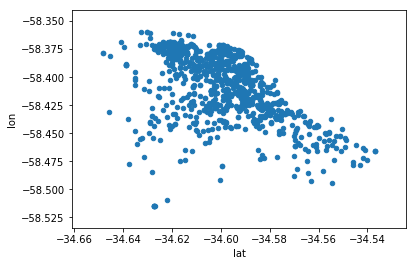

In [99]:
df.plot(x='lat',y='lon',kind='scatter')

In [0]:
import altair as alt
c = alt.Chart(df)

In [57]:
c.mark_circle().encode(
  latitude='lat:Q',
  longitude='lon:Q',
  size='Superficie Total:Q',
  color='monto:Q'
)

Output hidden; open in https://colab.research.google.com to view.

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:824: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:825: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


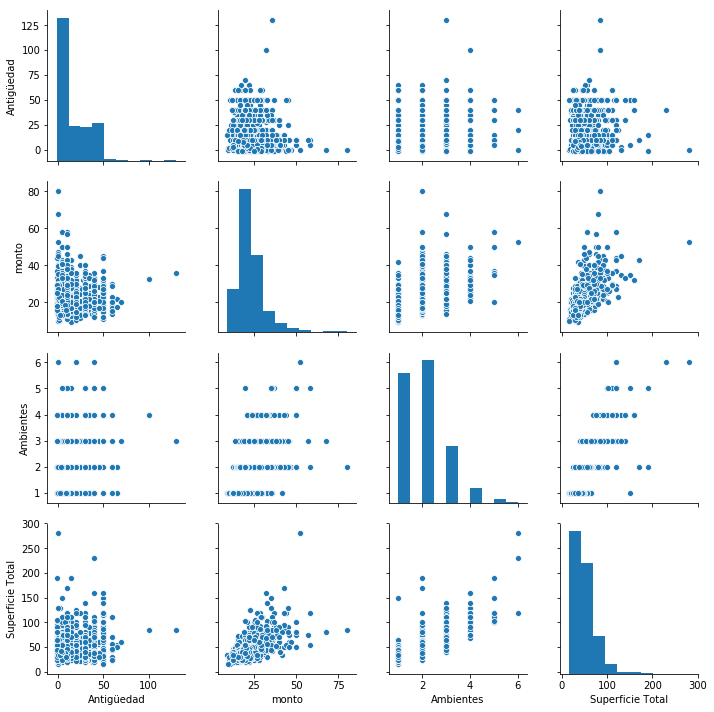

In [58]:
import seaborn as sns
sns.pairplot(df[['Antigüedad','monto','Ambientes','Superficie Total']])

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:824: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:825: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


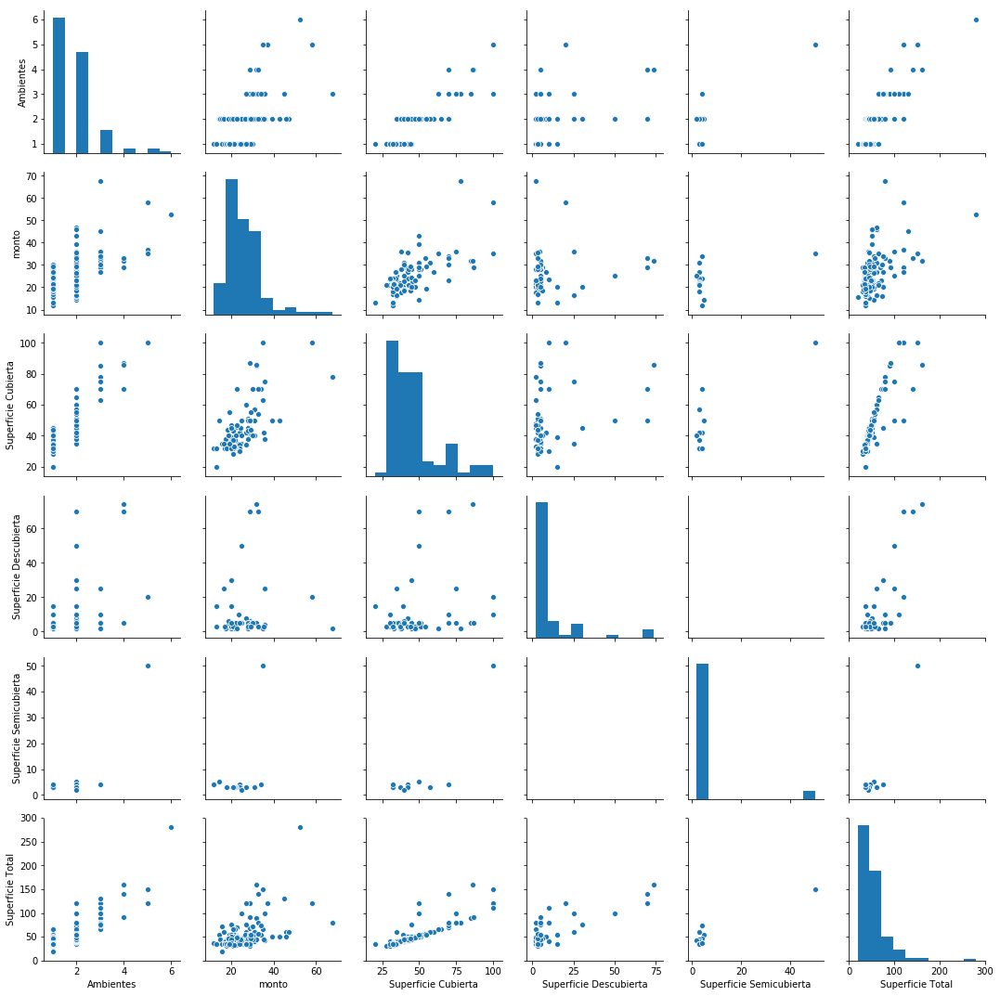

In [59]:
sns.pairplot(df.loc[df.Parrilla.notna(),['Ambientes','monto','Superficie Cubierta', 'Superficie Descubierta',
     'Superficie Semicubierta', 'Superficie Total']])

In [60]:
c.mark_circle().encode(
    alt.X('monto:Q', bin=True),
    alt.Y('Superficie Total:Q', bin=True),
    size='count()',
    color='Ambientes:N'
)


Chart({
  data:           Accesibilidad C/ Movilidad Reducida  ...  monto  periodo
  0     NaN                                  Si  ...    NaN  Por mes
  1     NaN                                 NaN  ...    NaN  Por mes
  2     NaN                                  Si  ...  32.00  Por mes
  3     NaN                                 NaN  ...  37.00  Por mes
  4     NaN                                 NaN  ...  25.00  Por mes
  5     NaN                                  Si  ...    NaN  Por mes
  6     NaN                                 NaN  ...  22.50  Por mes
  7     NaN                                  Si  ...  27.00  Por mes
  8     NaN                                  Si  ...  26.00  Por mes
  9     NaN                                  Si  ...  22.50  Por mes
  10    NaN                                 NaN  ...    NaN  Por mes
  11    NaN                                 NaN  ...    NaN  Por mes
  12    NaN                                 NaN  ...    NaN  Por mes
  13    NaN                                 NaN  ...  22.00  Por mes
  14    NaN                                  Si  ...    NaN  Por mes
  15    NaN                                  Si  ...  19.00  Por mes
  16    NaN                                 NaN  ...  15.50  Por mes
  17    NaN                                 NaN  ...  18.50  Por mes
  18    NaN                                  Si  ...  13.00  Por mes
  19    NaN                                 NaN  ...  16.50  Por mes
  20    NaN                                  Si  ...    NaN  Por mes
  21    NaN                                  Si  ...  67.50  Por mes
  22    NaN                                 NaN  ...  12.00  Por mes
  23    NaN                                  Si  ...  26.00  Por mes
  24    NaN                                  Si  ...  19.00  Por mes
  25    NaN                                 NaN  ...  21.00  Por mes
  26    NaN                                  Si  ...    NaN  Por mes
  27    NaN                                  Si  ...  20.00  Por mes
  28    NaN                                 NaN  ...  16.50  Por mes
  29    NaN                                  Si  ...    NaN  Por mes
  ...   ...                                 ...  ...    ...      ...
  1085  NaN                                 NaN  ...  12.00  Por mes
  1086  NaN                                 NaN  ...  17.00  Por mes
  1087  NaN                                 NaN  ...  22.00  Por mes
  1088  NaN                                  Si  ...  28.00  Por mes
  1089  NaN                                 NaN  ...  12.00  Por mes
  1090  NaN                                 NaN  ...  24.20  Por mes
  1091  NaN                                  Si  ...  32.00  Por mes
  1092  NaN                                 NaN  ...    NaN  Por mes
  1093  NaN                                  Si  ...  20.00  Por mes
  1094  NaN                                 NaN  ...  14.00  Por mes
  1095  NaN                                 NaN  ...  40.00  Por mes
  1096  NaN                                 NaN  ...  18.00  Por mes
  1097  NaN                                 NaN  ...  18.60  Por mes
  1098  NaN                                 NaN  ...  13.00  Por mes
  1099  NaN                                  Si  ...  20.40  Por mes
  1100  NaN                                  Si  ...  18.50  Por mes
  1101  NaN                                  Si  ...  17.00  Por mes
  1102  NaN                                  Si  ...  18.00  Por mes
  1103  NaN                                  Si  ...  17.00  Por mes
  1104  NaN                                 NaN  ...  38.00  Por mes
  1105  NaN                                  Si  ...  27.00  Por mes
  1106  NaN                                 NaN  ...  15.75  Por mes
  1107  NaN                                  Si  ...  26.00  Por mes
  1108  NaN                                 NaN  ...    NaN  Por mes
  1109  NaN                                 NaN  ...  20.00  Por mes
  1110  NaN                                 NaN  ... 

In [61]:
c.mark_circle().encode(
    alt.X(alt.repeat("column"), type='quantitative'),
    alt.Y(alt.repeat("row"), type='quantitative'),
    color='Ambientes:N'
).properties(
    width=150,
    height=150
).repeat(
    row=['monto'],
    column=['monto', 'Superficie Cubierta', 'Superficie Descubierta',
     'Superficie Semicubierta', 'Superficie Total']
).interactive()

RepeatChart({
  repeat: RepeatMapping({
    column: ['monto', 'Superficie Cubierta', 'Superficie Descubierta', 'Superficie Semicubierta', 'Superficie Total'],
    row: ['monto']
  }),
  spec: Chart({
    data:           Accesibilidad C/ Movilidad Reducida  ...  monto  periodo
    0     NaN                                  Si  ...    NaN  Por mes
    1     NaN                                 NaN  ...    NaN  Por mes
    2     NaN                                  Si  ...  32.00  Por mes
    3     NaN                                 NaN  ...  37.00  Por mes
    4     NaN                                 NaN  ...  25.00  Por mes
    5     NaN                                  Si  ...    NaN  Por mes
    6     NaN                                 NaN  ...  22.50  Por mes
    7     NaN                                  Si  ...  27.00  Por mes
    8     NaN                                  Si  ...  26.00  Por mes
    9     NaN                                  Si  ...  22.50  Por mes
    10    NaN                                 NaN  ...    NaN  Por mes
    11    NaN                                 NaN  ...    NaN  Por mes
    12    NaN                                 NaN  ...    NaN  Por mes
    13    NaN                                 NaN  ...  22.00  Por mes
    14    NaN                                  Si  ...    NaN  Por mes
    15    NaN                                  Si  ...  19.00  Por mes
    16    NaN                                 NaN  ...  15.50  Por mes
    17    NaN                                 NaN  ...  18.50  Por mes
    18    NaN                                  Si  ...  13.00  Por mes
    19    NaN                                 NaN  ...  16.50  Por mes
    20    NaN                                  Si  ...    NaN  Por mes
    21    NaN                                  Si  ...  67.50  Por mes
    22    NaN                                 NaN  ...  12.00  Por mes
    23    NaN                                  Si  ...  26.00  Por mes
    24    NaN                                  Si  ...  19.00  Por mes
    25    NaN                                 NaN  ...  21.00  Por mes
    26    NaN                                  Si  ...    NaN  Por mes
    27    NaN                                  Si  ...  20.00  Por mes
    28    NaN                                 NaN  ...  16.50  Por mes
    29    NaN                                  Si  ...    NaN  Por mes
    ...   ...                                 ...  ...    ...      ...
    1085  NaN                                 NaN  ...  12.00  Por mes
    1086  NaN                                 NaN  ...  17.00  Por mes
    1087  NaN                                 NaN  ...  22.00  Por mes
    1088  NaN                                  Si  ...  28.00  Por mes
    1089  NaN                                 NaN  ...  12.00  Por mes
    1090  NaN                                 NaN  ...  24.20  Por mes
    1091  NaN                                  Si  ...  32.00  Por mes
    1092  NaN                                 NaN  ...    NaN  Por mes
    1093  NaN                                  Si  ...  20.00  Por mes
    1094  NaN                                 NaN  ...  14.00  Por mes
    1095  NaN                                 NaN  ...  40.00  Por mes
    1096  NaN                                 NaN  ...  18.00  Por mes
    1097  NaN                                 NaN  ...  18.60  Por mes
    1098  NaN                                 NaN  ...  13.00  Por mes
    1099  NaN                                  Si  ...  20.40  Por mes
    1100  NaN                                  Si  ...  18.50  Por mes
    1101  NaN                                  Si  ...  17.00  Por mes
    1102  NaN                                  Si  ...  18.00  Por mes
    1103  NaN                                  Si  ...  17.00  Por mes
    1104  NaN                                 NaN  ...  38.00  Por mes
    1105  NaN                                  Si  ...  27.00  Por mes
    1106  NaN                  

In [62]:
c.mark_area(
    opacity=0.3,
    interpolate='step'
).encode(
    alt.X('monto:Q', bin=alt.Bin(maxbins=100)),
    alt.Y('count()', stack=None),
    alt.Color('Ambientes:N')
).facet(
    column='Parrilla:N'
)


FacetChart({
  data:           Accesibilidad C/ Movilidad Reducida  ...  monto  periodo
  0     NaN                                  Si  ...    NaN  Por mes
  1     NaN                                 NaN  ...    NaN  Por mes
  2     NaN                                  Si  ...  32.00  Por mes
  3     NaN                                 NaN  ...  37.00  Por mes
  4     NaN                                 NaN  ...  25.00  Por mes
  5     NaN                                  Si  ...    NaN  Por mes
  6     NaN                                 NaN  ...  22.50  Por mes
  7     NaN                                  Si  ...  27.00  Por mes
  8     NaN                                  Si  ...  26.00  Por mes
  9     NaN                                  Si  ...  22.50  Por mes
  10    NaN                                 NaN  ...    NaN  Por mes
  11    NaN                                 NaN  ...    NaN  Por mes
  12    NaN                                 NaN  ...    NaN  Por mes
  13    NaN                                 NaN  ...  22.00  Por mes
  14    NaN                                  Si  ...    NaN  Por mes
  15    NaN                                  Si  ...  19.00  Por mes
  16    NaN                                 NaN  ...  15.50  Por mes
  17    NaN                                 NaN  ...  18.50  Por mes
  18    NaN                                  Si  ...  13.00  Por mes
  19    NaN                                 NaN  ...  16.50  Por mes
  20    NaN                                  Si  ...    NaN  Por mes
  21    NaN                                  Si  ...  67.50  Por mes
  22    NaN                                 NaN  ...  12.00  Por mes
  23    NaN                                  Si  ...  26.00  Por mes
  24    NaN                                  Si  ...  19.00  Por mes
  25    NaN                                 NaN  ...  21.00  Por mes
  26    NaN                                  Si  ...    NaN  Por mes
  27    NaN                                  Si  ...  20.00  Por mes
  28    NaN                                 NaN  ...  16.50  Por mes
  29    NaN                                  Si  ...    NaN  Por mes
  ...   ...                                 ...  ...    ...      ...
  1085  NaN                                 NaN  ...  12.00  Por mes
  1086  NaN                                 NaN  ...  17.00  Por mes
  1087  NaN                                 NaN  ...  22.00  Por mes
  1088  NaN                                  Si  ...  28.00  Por mes
  1089  NaN                                 NaN  ...  12.00  Por mes
  1090  NaN                                 NaN  ...  24.20  Por mes
  1091  NaN                                  Si  ...  32.00  Por mes
  1092  NaN                                 NaN  ...    NaN  Por mes
  1093  NaN                                  Si  ...  20.00  Por mes
  1094  NaN                                 NaN  ...  14.00  Por mes
  1095  NaN                                 NaN  ...  40.00  Por mes
  1096  NaN                                 NaN  ...  18.00  Por mes
  1097  NaN                                 NaN  ...  18.60  Por mes
  1098  NaN                                 NaN  ...  13.00  Por mes
  1099  NaN                                  Si  ...  20.40  Por mes
  1100  NaN                                  Si  ...  18.50  Por mes
  1101  NaN                                  Si  ...  17.00  Por mes
  1102  NaN                                  Si  ...  18.00  Por mes
  1103  NaN                                  Si  ...  17.00  Por mes
  1104  NaN                                 NaN  ...  38.00  Por mes
  1105  NaN                                  Si  ...  27.00  Por mes
  1106  NaN                                 NaN  ...  15.75  Por mes
  1107  NaN                                  Si  ...  26.00  Por mes
  1108  NaN                                 NaN  ...    NaN  Por mes
  1109  NaN                                 NaN  ...  20.00  Por mes
  1110  NaN                                 NaN 

In [0]:
url = 'https://raw.githubusercontent.com/mgaitan/departamentos_argentina/master/departamentos-ciudad_autonoma_de_buenos_aires.json'
# url = 'https://github.com/mgaitan/departamentos_argentina/blob/master/departamentos-ciudad_autonoma_de_buenos_aires.topojson'

caba = alt.topo_feature(url, feature='')

mapa_caba = alt.Chart(caba).mark_geoshape(
    fill='lightgrey',
    stroke='white'
).properties(
    width=500,
    height=300
)

props = c.mark_circle().encode(
  latitude='lat:Q',
  longitude='lon:Q',
  size='Superficie Total:Q',
  color='monto:Q'
)


In [64]:
mapa_caba + props 

LayerChart({
  layer: [Chart({
    data: UrlData({
      format: TopoDataFormat({
        feature: '',
        type: 'topojson'
      }),
      url: 'https://raw.githubusercontent.com/mgaitan/departamentos_argentina/master/departamentos-ciudad_autonoma_de_buenos_aires.json'
    }),
    height: 300,
    mark: MarkDef({
      fill: 'lightgrey',
      stroke: 'white',
      type: 'geoshape'
    }),
    width: 500
  }), Chart({
    data:           Accesibilidad C/ Movilidad Reducida  ...  monto  periodo
    0     NaN                                  Si  ...    NaN  Por mes
    1     NaN                                 NaN  ...    NaN  Por mes
    2     NaN                                  Si  ...  32.00  Por mes
    3     NaN                                 NaN  ...  37.00  Por mes
    4     NaN                                 NaN  ...  25.00  Por mes
    5     NaN                                  Si  ...    NaN  Por mes
    6     NaN                                 NaN  ...  22.50  Por mes
    7     NaN                                  Si  ...  27.00  Por mes
    8     NaN                                  Si  ...  26.00  Por mes
    9     NaN                                  Si  ...  22.50  Por mes
    10    NaN                                 NaN  ...    NaN  Por mes
    11    NaN                                 NaN  ...    NaN  Por mes
    12    NaN                                 NaN  ...    NaN  Por mes
    13    NaN                                 NaN  ...  22.00  Por mes
    14    NaN                                  Si  ...    NaN  Por mes
    15    NaN                                  Si  ...  19.00  Por mes
    16    NaN                                 NaN  ...  15.50  Por mes
    17    NaN                                 NaN  ...  18.50  Por mes
    18    NaN                                  Si  ...  13.00  Por mes
    19    NaN                                 NaN  ...  16.50  Por mes
    20    NaN                                  Si  ...    NaN  Por mes
    21    NaN                                  Si  ...  67.50  Por mes
    22    NaN                                 NaN  ...  12.00  Por mes
    23    NaN                                  Si  ...  26.00  Por mes
    24    NaN                                  Si  ...  19.00  Por mes
    25    NaN                                 NaN  ...  21.00  Por mes
    26    NaN                                  Si  ...    NaN  Por mes
    27    NaN                                  Si  ...  20.00  Por mes
    28    NaN                                 NaN  ...  16.50  Por mes
    29    NaN                                  Si  ...    NaN  Por mes
    ...   ...                                 ...  ...    ...      ...
    1085  NaN                                 NaN  ...  12.00  Por mes
    1086  NaN                                 NaN  ...  17.00  Por mes
    1087  NaN                                 NaN  ...  22.00  Por mes
    1088  NaN                                  Si  ...  28.00  Por mes
    1089  NaN                                 NaN  ...  12.00  Por mes
    1090  NaN                                 NaN  ...  24.20  Por mes
    1091  NaN                                  Si  ...  32.00  Por mes
    1092  NaN                                 NaN  ...    NaN  Por mes
    1093  NaN                                  Si  ...  20.00  Por mes
    1094  NaN                                 NaN  ...  14.00  Por mes
    1095  NaN                                 NaN  ...  40.00  Por mes
    1096  NaN                                 NaN  ...  18.00  Por mes
    1097  NaN                                 NaN  ...  18.60  Por mes
    1098  NaN                                 NaN  ...  13.00  Por mes
    1099  NaN                                  Si  ...  20.40  Por mes
    1100  NaN                                  Si  ...  18.50  Por mes
    1101  NaN                                  Si  ...  17.00  Por mes
    1102  NaN                                  Si  ...  18.00  Por mes
    1103  NaN   

In [0]:
df['id'] = df.index

In [66]:
selector2 = alt.selection_single(empty='all', fields=['id'])
selector = alt.selection_multi(encodings=['color']) 

base = alt.Chart(df).properties(
    width=250,
    height=250
).add_selection(selector,selector2)


mapa_caba = alt.Chart(caba).mark_geoshape(
    fill='lightgrey',
    stroke='white'
).properties(
    width=500,
    height=300
)

props = base.mark_circle().encode(
  latitude='lat:Q',
  longitude='lon:Q',
  size='Superficie Total:Q',
  color= alt.condition(selector, 'monto:Q',alt.value('lightgray'), legend=None),
  tooltip=['id','monto','Ambientes','Superficie Cubierta'],
)

mapa =  mapa_caba + props 

precios = base.mark_circle().encode(
    x='Superficie Cubierta:Q',
    y='monto:Q',
    color=alt.condition(selector, 'Ambientes:N', alt.value('lightgray'), legend=None),
    tooltip=['id','monto','Ambientes','Superficie Cubierta'],
).properties(
    width=150,
    height=150
)
# timeseries = base.mark_line().encode(
#     x='time',
#     y=alt.Y('value', scale=alt.Scale(domain=(-15, 15))),
#     color=alt.Color('id:O', legend=None)
# ).transform_filter(
#     selector
# )

ambientes = base.mark_rect().encode(
  alt.Y('Ambientes:O'),
  color=alt.condition(selector, 'Ambientes:N', alt.value('lightgray'), legend=None),  
)

# points | timeseries
# mapa 
ambientes | precios | mapa

HConcatChart({
  data:           Accesibilidad C/ Movilidad Reducida  ...  periodo    id
  0     NaN                                  Si  ...  Por mes     0
  1     NaN                                 NaN  ...  Por mes     1
  2     NaN                                  Si  ...  Por mes     2
  3     NaN                                 NaN  ...  Por mes     3
  4     NaN                                 NaN  ...  Por mes     4
  5     NaN                                  Si  ...  Por mes     5
  6     NaN                                 NaN  ...  Por mes     6
  7     NaN                                  Si  ...  Por mes     7
  8     NaN                                  Si  ...  Por mes     8
  9     NaN                                  Si  ...  Por mes     9
  10    NaN                                 NaN  ...  Por mes    10
  11    NaN                                 NaN  ...  Por mes    11
  12    NaN                                 NaN  ...  Por mes    12
  13    NaN                                 NaN  ...  Por mes    13
  14    NaN                                  Si  ...  Por mes    14
  15    NaN                                  Si  ...  Por mes    15
  16    NaN                                 NaN  ...  Por mes    16
  17    NaN                                 NaN  ...  Por mes    17
  18    NaN                                  Si  ...  Por mes    18
  19    NaN                                 NaN  ...  Por mes    19
  20    NaN                                  Si  ...  Por mes    20
  21    NaN                                  Si  ...  Por mes    21
  22    NaN                                 NaN  ...  Por mes    22
  23    NaN                                  Si  ...  Por mes    23
  24    NaN                                  Si  ...  Por mes    24
  25    NaN                                 NaN  ...  Por mes    25
  26    NaN                                  Si  ...  Por mes    26
  27    NaN                                  Si  ...  Por mes    27
  28    NaN                                 NaN  ...  Por mes    28
  29    NaN                                  Si  ...  Por mes    29
  ...   ...                                 ...  ...      ...   ...
  1085  NaN                                 NaN  ...  Por mes  1085
  1086  NaN                                 NaN  ...  Por mes  1086
  1087  NaN                                 NaN  ...  Por mes  1087
  1088  NaN                                  Si  ...  Por mes  1088
  1089  NaN                                 NaN  ...  Por mes  1089
  1090  NaN                                 NaN  ...  Por mes  1090
  1091  NaN                                  Si  ...  Por mes  1091
  1092  NaN                                 NaN  ...  Por mes  1092
  1093  NaN                                  Si  ...  Por mes  1093
  1094  NaN                                 NaN  ...  Por mes  1094
  1095  NaN                                 NaN  ...  Por mes  1095
  1096  NaN                                 NaN  ...  Por mes  1096
  1097  NaN                                 NaN  ...  Por mes  1097
  1098  NaN                                 NaN  ...  Por mes  1098
  1099  NaN                                  Si  ...  Por mes  1099
  1100  NaN                                  Si  ...  Por mes  1100
  1101  NaN                                  Si  ...  Por mes  1101
  1102  NaN                                  Si  ...  Por mes  1102
  1103  NaN                                  Si  ...  Por mes  1103
  1104  NaN                                 NaN  ...  Por mes  1104
  1105  NaN                                  Si  ...  Por mes  1105
  1106  NaN                                 NaN  ...  Por mes  1106
  1107  NaN                                  Si  ...  Por mes  1107
  1108  NaN                                 NaN  ...  Por mes  1108
  1109  NaN                                 NaN  ...  Por mes  1109
  1110  NaN                                 NaN  ...  Por mes  1110
  1111  NaN                        

# Analisis de las demas columnas

In [0]:
# elimino de df las columnas que tienen listas como elementos
descriptions, cls = df.pop('Descripcion'),df.pop('class')

In [0]:
# convierto las columnas que tienen Si y nan a valores binarios 
binary_columns = []
for col in df.columns:
  if len(df[col].unique()) == 2:
    df[col] = df[col].notna()
    binary_columns.append(col)
    

In [0]:
import matplotlib.pyplot as plt
from sklearn import manifold
from sklearn.decomposition import PCA

df2 = df[binary_columns]

In [0]:
def ISO2(neighbors=3):
  plt.figure()
  iso = manifold.Isomap(n_neighbors=neighbors,n_components=2)
  iso.fit(df2)
  T_iso =  iso.transform(df2)
  plt.scatter(T_iso[:,0],T_iso[:,1],marker='.')

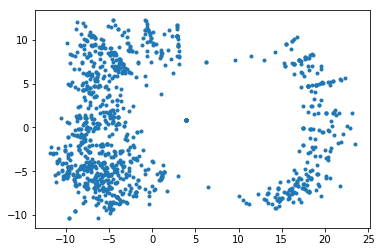

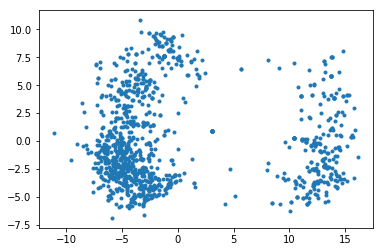

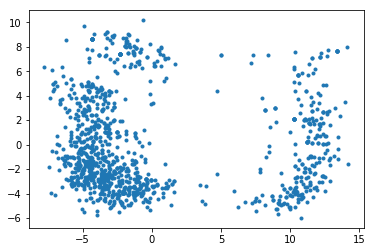

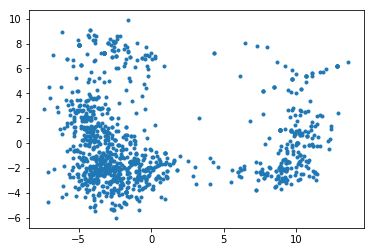

In [107]:
for n in range(2,6):
  ISO2(n)

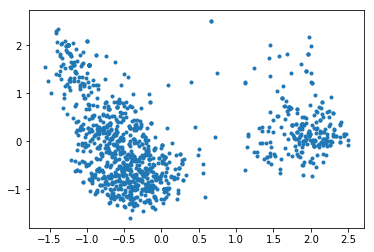

In [108]:
pca = PCA(n_components=3, svd_solver='full')
pca.fit(df2)
T_pca = pca.transform(df2)
plt.scatter(T_pca[:,0],T_pca[:,1],marker='.')

In [0]:
def plot(ax,T,x,y,c=None):
    ax.set_xlabel('Component: {0}'.format(x))
    ax.set_ylabel('Component: {0}'.format(y))
    ax.scatter(T[:,x],T[:,y], marker='.',alpha=0.7,c=c)

def plot3(T,c=None):
    fig = plt.figure()
    ax = fig.add_subplot(221)
    plot(ax,T,0,1,c)
    
    ax = fig.add_subplot(222)
    plot(ax,T,2,1,c)
    
    ax = fig.add_subplot(223)
    plot(ax,T,0,2,c)


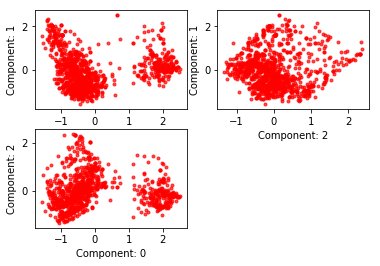

In [110]:
plot3(T_pca,c='r')

In [0]:
def ISO3(neighbors=3):
#   plt.figure()
  iso = manifold.Isomap(n_neighbors=neighbors,n_components=3)
  iso.fit(df2)
  T_iso =  iso.transform(df2)
  plot3(T_iso)

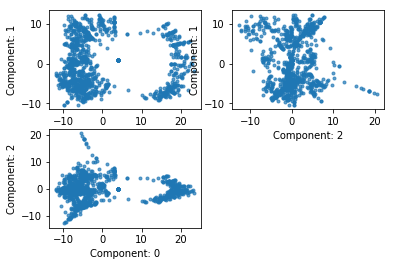

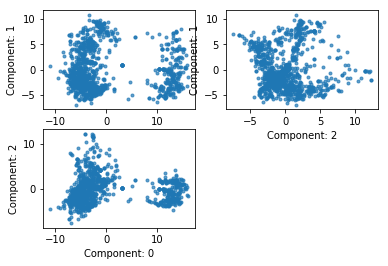

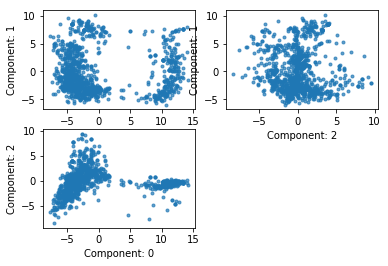

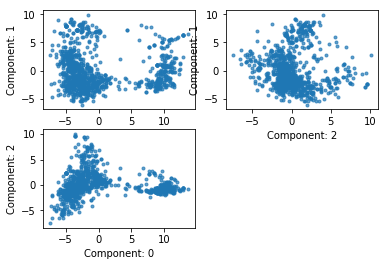

In [112]:
for n in range(2,6):
  ISO3(n)

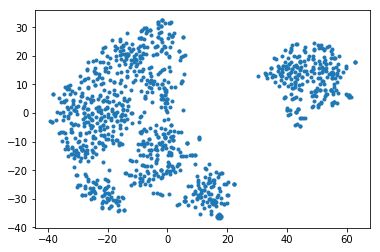

In [113]:
plt.figure()
tsne = manifold.TSNE(n_components=2)
tsne.fit(df2)
T_tsne =  tsne.fit_transform(df2)
plt.scatter(T_tsne[:,0],T_tsne[:,1],marker='.')

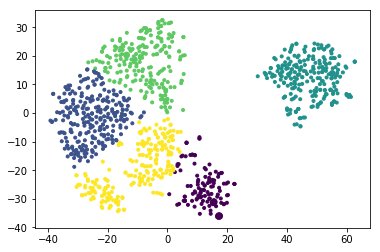

In [114]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=5, random_state=0)
kmeans.fit(T_tsne)
k = kmeans.predict(T_tsne)
# k.uniq()
plt.scatter(T_tsne[:,0],T_tsne[:,1],marker='.',c=k)

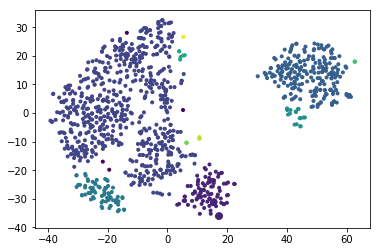

In [115]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=3, min_samples=2)
c_db=dbscan.fit_predict(T_tsne)
plt.scatter(T_tsne[:,0],T_tsne[:,1],marker='.',c=c_db)

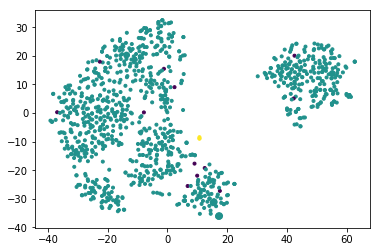

In [116]:
c_db_full = dbscan.fit_predict(df2)
plt.scatter(T_tsne[:,0],T_tsne[:,1],marker='.',c=c_db_full)

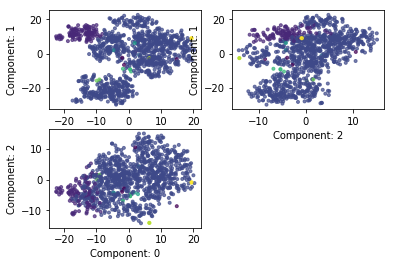

In [117]:
tsne2 = manifold.TSNE(n_components=3)
T_tsne2 =  tsne2.fit_transform(df2)

c_db_full = dbscan.fit_predict(T_tsne2)
plot3(T_tsne2,c=c_db_full)

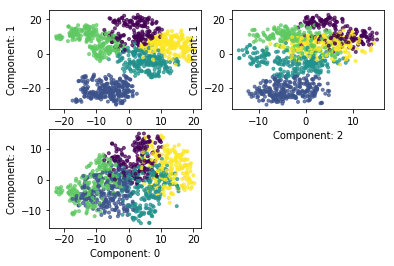

In [118]:
kmeans = KMeans(n_clusters=5, random_state=0)
kmeans.fit(T_tsne2)
k_full = kmeans.predict(T_tsne2)
plot3(T_tsne2,c=k_full)

In [0]:
len(df.columns),len(df2.columns)
df3 = df[set(df.columns) - set(binary_columns)].copy()
chart = alt.Chart(df3)

In [84]:
chart.mark_circle().encode(
    y='monto:Q',
    x='Barrio:N',
    color='Ambientes:N',
    size='Superficie Cubierta:Q',
    row=alt.Row('Ambientes:N'),
    tooltip=['id','monto','Ambientes','Superficie Cubierta'],
)

Chart({
  data:      Superficie cubierta Antiguedad Baños  ...  monto  Superficies   Disposición
  0                    NaN        NaN     1  ...    NaN          NaN        Frente
  1                    NaN        NaN     1  ...    NaN          NaN        Frente
  2                    NaN        NaN     1  ...  32.00          NaN       Lateral
  3                   0 m²         30     2  ...  37.00          NaN  Contrafrente
  4                    NaN        NaN     1  ...  25.00          NaN  Contrafrente
  5                    NaN        NaN     1  ...    NaN          NaN  Contrafrente
  6                    NaN        NaN     1  ...  22.50          NaN  Contrafrente
  7                    NaN        NaN     1  ...  27.00          NaN  Contrafrente
  8                    NaN        NaN     1  ...  26.00          NaN        Frente
  9                    NaN        NaN     1  ...  22.50          NaN  Contrafrente
  10                   NaN        NaN     2  ...    NaN          NaN        Frente
  11                   NaN        NaN     1  ...    NaN          NaN        Frente
  12                   NaN        NaN     1  ...    NaN          NaN        Frente
  13                   NaN        NaN     1  ...  22.00          NaN  Contrafrente
  14                   NaN        NaN     1  ...    NaN          NaN        Frente
  15                   NaN        NaN     1  ...  19.00          NaN  Contrafrente
  16                   NaN        NaN     1  ...  15.50          NaN  Contrafrente
  17                  0 m²         60     1  ...  18.50          NaN        Frente
  18                   NaN        NaN     1  ...  13.00          NaN        Frente
  19                   NaN        NaN     1  ...  16.50          NaN  Contrafrente
  20                   NaN        NaN     1  ...    NaN          NaN        Frente
  21                   NaN        NaN     2  ...  67.50          NaN        Frente
  22                   NaN        NaN     1  ...  12.00          NaN  Contrafrente
  23                   NaN        NaN     1  ...  26.00          NaN        Frente
  24                   NaN        NaN     1  ...  19.00          NaN  Contrafrente
  25                   NaN        NaN     1  ...  21.00          NaN  Contrafrente
  26                   NaN        NaN     1  ...    NaN          NaN        Frente
  27                   NaN        NaN     1  ...  20.00          NaN       Interno
  28                   NaN        NaN     1  ...  16.50          NaN  Contrafrente
  29                   NaN        NaN     2  ...    NaN          NaN        Frente
  ...                  ...        ...   ...  ...    ...          ...           ...
  1085                 NaN        NaN     1  ...  12.00          NaN        Frente
  1086                 NaN        NaN     1  ...  17.00          NaN  Contrafrente
  1087               70 m²         30     1  ...  22.00          NaN       Interno
  1088                 NaN        NaN     1  ...  28.00          NaN        Frente
  1089                 NaN        NaN     1  ...  12.00          NaN  Contrafrente
  1090                 NaN        NaN     1  ...  24.20          NaN        Frente
  1091                 NaN        NaN     2  ...  32.00          NaN        Frente
  1092                 NaN        NaN     1  ...    NaN          NaN        Frente
  1093                 NaN        NaN     3  ...  20.00          NaN        Frente
  1094                 NaN        NaN     1  ...  14.00          NaN  Contrafrente
  1095                 NaN        NaN     1  ...  40.00          NaN  Contrafrente
  1096                 NaN        NaN     1  ...  18.00          NaN  Contrafrente
  1097                 NaN        NaN     1  ...  18.60          NaN  Contrafrente
  1098                 NaN        NaN     1  ...  13.00          NaN        Frente
  1099                 NaN        NaN     1  ...  20.40          NaN  Contrafrente
  1100                 NaN        NaN     1  ...  18.50          NaN        Frente
  

In [0]:
df4 = df3.copy()
df4['labels'] = k_full
chart2 = alt.Chart(df4).properties(
    width=500,
    height=300
)

In [86]:
chart2.mark_circle().encode(
    y='monto:Q',
    size='Superficie Total:Q',
    x='labels:N',
    color='Ambientes:N',
)
# mapa_caba
# df4

Chart({
  data:      Superficie cubierta Antiguedad Baños  ...  Superficies   Disposición labels
  0                    NaN        NaN     1  ...          NaN        Frente      4
  1                    NaN        NaN     1  ...          NaN        Frente      2
  2                    NaN        NaN     1  ...          NaN       Lateral      0
  3                   0 m²         30     2  ...          NaN  Contrafrente      3
  4                    NaN        NaN     1  ...          NaN  Contrafrente      3
  5                    NaN        NaN     1  ...          NaN  Contrafrente      4
  6                    NaN        NaN     1  ...          NaN  Contrafrente      2
  7                    NaN        NaN     1  ...          NaN  Contrafrente      4
  8                    NaN        NaN     1  ...          NaN        Frente      4
  9                    NaN        NaN     1  ...          NaN  Contrafrente      4
  10                   NaN        NaN     2  ...          NaN        Frente      2
  11                   NaN        NaN     1  ...          NaN        Frente      2
  12                   NaN        NaN     1  ...          NaN        Frente      3
  13                   NaN        NaN     1  ...          NaN  Contrafrente      1
  14                   NaN        NaN     1  ...          NaN        Frente      4
  15                   NaN        NaN     1  ...          NaN  Contrafrente      3
  16                   NaN        NaN     1  ...          NaN  Contrafrente      3
  17                  0 m²         60     1  ...          NaN        Frente      2
  18                   NaN        NaN     1  ...          NaN        Frente      3
  19                   NaN        NaN     1  ...          NaN  Contrafrente      2
  20                   NaN        NaN     1  ...          NaN        Frente      4
  21                   NaN        NaN     2  ...          NaN        Frente      4
  22                   NaN        NaN     1  ...          NaN  Contrafrente      3
  23                   NaN        NaN     1  ...          NaN        Frente      4
  24                   NaN        NaN     1  ...          NaN  Contrafrente      3
  25                   NaN        NaN     1  ...          NaN  Contrafrente      3
  26                   NaN        NaN     1  ...          NaN        Frente      4
  27                   NaN        NaN     1  ...          NaN       Interno      3
  28                   NaN        NaN     1  ...          NaN  Contrafrente      2
  29                   NaN        NaN     2  ...          NaN        Frente      0
  ...                  ...        ...   ...  ...          ...           ...    ...
  1085                 NaN        NaN     1  ...          NaN        Frente      1
  1086                 NaN        NaN     1  ...          NaN  Contrafrente      1
  1087               70 m²         30     1  ...          NaN       Interno      3
  1088                 NaN        NaN     1  ...          NaN        Frente      0
  1089                 NaN        NaN     1  ...          NaN  Contrafrente      3
  1090                 NaN        NaN     1  ...          NaN        Frente      2
  1091                 NaN        NaN     2  ...          NaN        Frente      3
  1092                 NaN        NaN     1  ...          NaN        Frente      2
  1093                 NaN        NaN     3  ...          NaN        Frente      0
  1094                 NaN        NaN     1  ...          NaN  Contrafrente      2
  1095                 NaN        NaN     1  ...          NaN  Contrafrente      2
  1096                 NaN        NaN     1  ...          NaN  Contrafrente      3
  1097                 NaN        NaN     1  ...          NaN  Contrafrente      1
  1098                 NaN        NaN     1  ...          NaN        Frente      2
  1099                 NaN        NaN     1  ...          NaN  Contrafrente      0
  1100                 NaN        NaN     1  ...          NaN        Frente      4
  

In [87]:
chart2.mark_bar().encode(
    y='labels:N',
    # size='count()',
    x='count(Ambientes):N',
    color='Ambientes:N',
)

Chart({
  data:      Superficie cubierta Antiguedad Baños  ...  Superficies   Disposición labels
  0                    NaN        NaN     1  ...          NaN        Frente      4
  1                    NaN        NaN     1  ...          NaN        Frente      2
  2                    NaN        NaN     1  ...          NaN       Lateral      0
  3                   0 m²         30     2  ...          NaN  Contrafrente      3
  4                    NaN        NaN     1  ...          NaN  Contrafrente      3
  5                    NaN        NaN     1  ...          NaN  Contrafrente      4
  6                    NaN        NaN     1  ...          NaN  Contrafrente      2
  7                    NaN        NaN     1  ...          NaN  Contrafrente      4
  8                    NaN        NaN     1  ...          NaN        Frente      4
  9                    NaN        NaN     1  ...          NaN  Contrafrente      4
  10                   NaN        NaN     2  ...          NaN        Frente      2
  11                   NaN        NaN     1  ...          NaN        Frente      2
  12                   NaN        NaN     1  ...          NaN        Frente      3
  13                   NaN        NaN     1  ...          NaN  Contrafrente      1
  14                   NaN        NaN     1  ...          NaN        Frente      4
  15                   NaN        NaN     1  ...          NaN  Contrafrente      3
  16                   NaN        NaN     1  ...          NaN  Contrafrente      3
  17                  0 m²         60     1  ...          NaN        Frente      2
  18                   NaN        NaN     1  ...          NaN        Frente      3
  19                   NaN        NaN     1  ...          NaN  Contrafrente      2
  20                   NaN        NaN     1  ...          NaN        Frente      4
  21                   NaN        NaN     2  ...          NaN        Frente      4
  22                   NaN        NaN     1  ...          NaN  Contrafrente      3
  23                   NaN        NaN     1  ...          NaN        Frente      4
  24                   NaN        NaN     1  ...          NaN  Contrafrente      3
  25                   NaN        NaN     1  ...          NaN  Contrafrente      3
  26                   NaN        NaN     1  ...          NaN        Frente      4
  27                   NaN        NaN     1  ...          NaN       Interno      3
  28                   NaN        NaN     1  ...          NaN  Contrafrente      2
  29                   NaN        NaN     2  ...          NaN        Frente      0
  ...                  ...        ...   ...  ...          ...           ...    ...
  1085                 NaN        NaN     1  ...          NaN        Frente      1
  1086                 NaN        NaN     1  ...          NaN  Contrafrente      1
  1087               70 m²         30     1  ...          NaN       Interno      3
  1088                 NaN        NaN     1  ...          NaN        Frente      0
  1089                 NaN        NaN     1  ...          NaN  Contrafrente      3
  1090                 NaN        NaN     1  ...          NaN        Frente      2
  1091                 NaN        NaN     2  ...          NaN        Frente      3
  1092                 NaN        NaN     1  ...          NaN        Frente      2
  1093                 NaN        NaN     3  ...          NaN        Frente      0
  1094                 NaN        NaN     1  ...          NaN  Contrafrente      2
  1095                 NaN        NaN     1  ...          NaN  Contrafrente      2
  1096                 NaN        NaN     1  ...          NaN  Contrafrente      3
  1097                 NaN        NaN     1  ...          NaN  Contrafrente      1
  1098                 NaN        NaN     1  ...          NaN        Frente      2
  1099                 NaN        NaN     1  ...          NaN  Contrafrente      0
  1100                 NaN        NaN     1  ...          NaN        Frente      4
  

In [88]:
chart2.mark_circle().encode(
    x='Barrio:N',
    size='count()',
    y='labels:N',
    color='Ambientes:N'
)

Chart({
  data:      Superficie cubierta Antiguedad Baños  ...  Superficies   Disposición labels
  0                    NaN        NaN     1  ...          NaN        Frente      4
  1                    NaN        NaN     1  ...          NaN        Frente      2
  2                    NaN        NaN     1  ...          NaN       Lateral      0
  3                   0 m²         30     2  ...          NaN  Contrafrente      3
  4                    NaN        NaN     1  ...          NaN  Contrafrente      3
  5                    NaN        NaN     1  ...          NaN  Contrafrente      4
  6                    NaN        NaN     1  ...          NaN  Contrafrente      2
  7                    NaN        NaN     1  ...          NaN  Contrafrente      4
  8                    NaN        NaN     1  ...          NaN        Frente      4
  9                    NaN        NaN     1  ...          NaN  Contrafrente      4
  10                   NaN        NaN     2  ...          NaN        Frente      2
  11                   NaN        NaN     1  ...          NaN        Frente      2
  12                   NaN        NaN     1  ...          NaN        Frente      3
  13                   NaN        NaN     1  ...          NaN  Contrafrente      1
  14                   NaN        NaN     1  ...          NaN        Frente      4
  15                   NaN        NaN     1  ...          NaN  Contrafrente      3
  16                   NaN        NaN     1  ...          NaN  Contrafrente      3
  17                  0 m²         60     1  ...          NaN        Frente      2
  18                   NaN        NaN     1  ...          NaN        Frente      3
  19                   NaN        NaN     1  ...          NaN  Contrafrente      2
  20                   NaN        NaN     1  ...          NaN        Frente      4
  21                   NaN        NaN     2  ...          NaN        Frente      4
  22                   NaN        NaN     1  ...          NaN  Contrafrente      3
  23                   NaN        NaN     1  ...          NaN        Frente      4
  24                   NaN        NaN     1  ...          NaN  Contrafrente      3
  25                   NaN        NaN     1  ...          NaN  Contrafrente      3
  26                   NaN        NaN     1  ...          NaN        Frente      4
  27                   NaN        NaN     1  ...          NaN       Interno      3
  28                   NaN        NaN     1  ...          NaN  Contrafrente      2
  29                   NaN        NaN     2  ...          NaN        Frente      0
  ...                  ...        ...   ...  ...          ...           ...    ...
  1085                 NaN        NaN     1  ...          NaN        Frente      1
  1086                 NaN        NaN     1  ...          NaN  Contrafrente      1
  1087               70 m²         30     1  ...          NaN       Interno      3
  1088                 NaN        NaN     1  ...          NaN        Frente      0
  1089                 NaN        NaN     1  ...          NaN  Contrafrente      3
  1090                 NaN        NaN     1  ...          NaN        Frente      2
  1091                 NaN        NaN     2  ...          NaN        Frente      3
  1092                 NaN        NaN     1  ...          NaN        Frente      2
  1093                 NaN        NaN     3  ...          NaN        Frente      0
  1094                 NaN        NaN     1  ...          NaN  Contrafrente      2
  1095                 NaN        NaN     1  ...          NaN  Contrafrente      2
  1096                 NaN        NaN     1  ...          NaN  Contrafrente      3
  1097                 NaN        NaN     1  ...          NaN  Contrafrente      1
  1098                 NaN        NaN     1  ...          NaN        Frente      2
  1099                 NaN        NaN     1  ...          NaN  Contrafrente      0
  1100                 NaN        NaN     1  ...          NaN        Frente      4
  

In [89]:
chart2.mark_circle().encode(
    x='monto:Q',
    y='Superficie Total:Q',
    color='labels:O',
    size='Superficie Cubierta:Q',
    column=alt.Column('Ambientes:N'),
    tooltip=['id','monto','Ambientes','Superficie Cubierta'],
)

Chart({
  data:      Superficie cubierta Antiguedad Baños  ...  Superficies   Disposición labels
  0                    NaN        NaN     1  ...          NaN        Frente      4
  1                    NaN        NaN     1  ...          NaN        Frente      2
  2                    NaN        NaN     1  ...          NaN       Lateral      0
  3                   0 m²         30     2  ...          NaN  Contrafrente      3
  4                    NaN        NaN     1  ...          NaN  Contrafrente      3
  5                    NaN        NaN     1  ...          NaN  Contrafrente      4
  6                    NaN        NaN     1  ...          NaN  Contrafrente      2
  7                    NaN        NaN     1  ...          NaN  Contrafrente      4
  8                    NaN        NaN     1  ...          NaN        Frente      4
  9                    NaN        NaN     1  ...          NaN  Contrafrente      4
  10                   NaN        NaN     2  ...          NaN        Frente      2
  11                   NaN        NaN     1  ...          NaN        Frente      2
  12                   NaN        NaN     1  ...          NaN        Frente      3
  13                   NaN        NaN     1  ...          NaN  Contrafrente      1
  14                   NaN        NaN     1  ...          NaN        Frente      4
  15                   NaN        NaN     1  ...          NaN  Contrafrente      3
  16                   NaN        NaN     1  ...          NaN  Contrafrente      3
  17                  0 m²         60     1  ...          NaN        Frente      2
  18                   NaN        NaN     1  ...          NaN        Frente      3
  19                   NaN        NaN     1  ...          NaN  Contrafrente      2
  20                   NaN        NaN     1  ...          NaN        Frente      4
  21                   NaN        NaN     2  ...          NaN        Frente      4
  22                   NaN        NaN     1  ...          NaN  Contrafrente      3
  23                   NaN        NaN     1  ...          NaN        Frente      4
  24                   NaN        NaN     1  ...          NaN  Contrafrente      3
  25                   NaN        NaN     1  ...          NaN  Contrafrente      3
  26                   NaN        NaN     1  ...          NaN        Frente      4
  27                   NaN        NaN     1  ...          NaN       Interno      3
  28                   NaN        NaN     1  ...          NaN  Contrafrente      2
  29                   NaN        NaN     2  ...          NaN        Frente      0
  ...                  ...        ...   ...  ...          ...           ...    ...
  1085                 NaN        NaN     1  ...          NaN        Frente      1
  1086                 NaN        NaN     1  ...          NaN  Contrafrente      1
  1087               70 m²         30     1  ...          NaN       Interno      3
  1088                 NaN        NaN     1  ...          NaN        Frente      0
  1089                 NaN        NaN     1  ...          NaN  Contrafrente      3
  1090                 NaN        NaN     1  ...          NaN        Frente      2
  1091                 NaN        NaN     2  ...          NaN        Frente      3
  1092                 NaN        NaN     1  ...          NaN        Frente      2
  1093                 NaN        NaN     3  ...          NaN        Frente      0
  1094                 NaN        NaN     1  ...          NaN  Contrafrente      2
  1095                 NaN        NaN     1  ...          NaN  Contrafrente      2
  1096                 NaN        NaN     1  ...          NaN  Contrafrente      3
  1097                 NaN        NaN     1  ...          NaN  Contrafrente      1
  1098                 NaN        NaN     1  ...          NaN        Frente      2
  1099                 NaN        NaN     1  ...          NaN  Contrafrente      0
  1100                 NaN        NaN     1  ...          NaN        Frente      4
  

In [0]:
columns = set(['monto', 'Pisos', 'link', 'Total construido', 'Superficie cubierta',
       'Antigüedad', 'Ambientes', 'Expensas', 'Dormitorios',
       'Superficie Descubierta', 'Superficies', 'Baños', 'Disposición',
       'Orientación', 'Superficie Total', 'Condición', 'Superficie Cubierta',
       'Superficie Semicubierta', 'Toilettes', 'lat', 'id', 'Antiguedad',
       'Situación', 'Barrio', 'lon', 'Dtos. Por Piso', 'Amoblado', 'Dirección',
       'Cantidad De Pisos', 'labels'])

unused_cols = set([ 'link', 'Superficie cubierta',
       'Superficies', 'Dtos. Por Piso', 'Dirección',
       'Cantidad De Pisos' ])

In [122]:
from sklearn.preprocessing import OneHotEncoder,LabelEncoder
enc = OneHotEncoder(handle_unknown='ignore')
cat = enc.fit_transform(df4[categorical_cols])

ValueError: ignored

In [121]:
T_tsne3 =  tsne2.fit_transform(cat.toarray())
plot3(T_tsne3)

NameError: ignored

In [0]:
kmeans = KMeans(n_clusters=5, random_state=0)
kmeans.fit(T_tsne3)
k = kmeans.predict(T_tsne3)
plot3(T_tsne3,c=k)

In [97]:
len(df4[categorical_cols].dropna())

738